<a href="https://colab.research.google.com/github/SimonsKeyboardCat/face_detection/blob/main/face_detect.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## *Nagłówek sprawozdania*

*kto, kiedy, na jakich zajęciach, itp., itd. - do uzypełnienia!*

# Analiza obrazu - detekcja twarzy

## Inicjalizacja
import bibliotek, pobranie do lokalnego środowiska wykonawczego przykładowego obrazu testowego i modeli dla detektorów twarzy

In [1]:
import cv2
from google.colab.patches import cv2_imshow

import dlib

# biblioteka insightface wymaga zainstalowania
!pip install insightface
!pip install onnxruntime

import insightface

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.5/439.5 kB 7.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 72.8 MB/s eta 0:00:00
  Created wheel for insightface: filename=insightface-0.7.3-cp310-cp310-linux_x86_64.whl size=1054150 sha256=80b2d64ecf67e0f94359a7d135095a1d8e8667268bdadeb02f1d99b314b76d40
  Stored in directory: /root/.cache/pip/wheels/e3/d0/80/e3773fb8b6d1cca87ea1d33d9b1f20a223a6493c896da249b5
Successfully built insightface
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 68.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 11.9 MB/s eta 0:00:00


In [2]:
# obraz testowy
# https://drive.google.com/file/d/1dKxVJO0n5O6VuiHDdvrS36touzAeCgbw/view?usp=sharing
!gdown 1dKxVJO0n5O6VuiHDdvrS36touzAeCgbw

Downloading...
From: https://drive.google.com/uc?id=1dKxVJO0n5O6VuiHDdvrS36touzAeCgbw
To: /content/2_Demonstration_Demonstration_Or_Protest_2_58.jpg
100% 173k/173k [00:00<00:00, 118MB/s]


In [3]:
# model detektora Haar
# https://drive.google.com/file/d/1k2J4-4yIXrFFHZUhFv4pCRqcl-wB2Ve9/view?usp=sharing
!gdown 1k2J4-4yIXrFFHZUhFv4pCRqcl-wB2Ve9
!unzip haarcascade_frontalface_default.zip

Downloading...
From: https://drive.google.com/uc?id=1k2J4-4yIXrFFHZUhFv4pCRqcl-wB2Ve9
To: /content/haarcascade_frontalface_default.zip
100% 140k/140k [00:00<00:00, 109MB/s]
Archive:  haarcascade_frontalface_default.zip
  inflating: haarcascade_frontalface_default.xml  


In [4]:
# model detektora MMOD (sieć neuronowa z biblioteki dlib)
# https://drive.google.com/file/d/1gwFX_zny4A6DVkQ2gV2FlKY39qh1iDYj/view?usp=sharing
!gdown 1gwFX_zny4A6DVkQ2gV2FlKY39qh1iDYj

Downloading...
From: https://drive.google.com/uc?id=1gwFX_zny4A6DVkQ2gV2FlKY39qh1iDYj
To: /content/mmod_human_face_detector.dat
100% 730k/730k [00:00<00:00, 114MB/s]


In [5]:
# modele detektora twarzy (siec neuronowa) z biblioteki insightface
!gdown 1avyNxM0XoYh8YfxhhZoCvvI0lE7qT8Gy
!unzip insightface.zip

Downloading...
From: https://drive.google.com/uc?id=1avyNxM0XoYh8YfxhhZoCvvI0lE7qT8Gy
To: /content/insightface.zip
100% 23.4M/23.4M [00:01<00:00, 20.2MB/s]
Archive:  insightface.zip
   creating: insightface/models/
   creating: insightface/models/buffalo_l/
  inflating: insightface/models/buffalo_l/det_10g.onnx  
   creating: insightface/models/buffalo_m/
  inflating: insightface/models/buffalo_m/det_2.5g.onnx  
   creating: insightface/models/buffalo_s/
  inflating: insightface/models/buffalo_s/det_500m.onnx  
   creating: insightface/models/buffalo_sc/
  inflating: insightface/models/buffalo_sc/det_500m.onnx  


## Obraz testowy

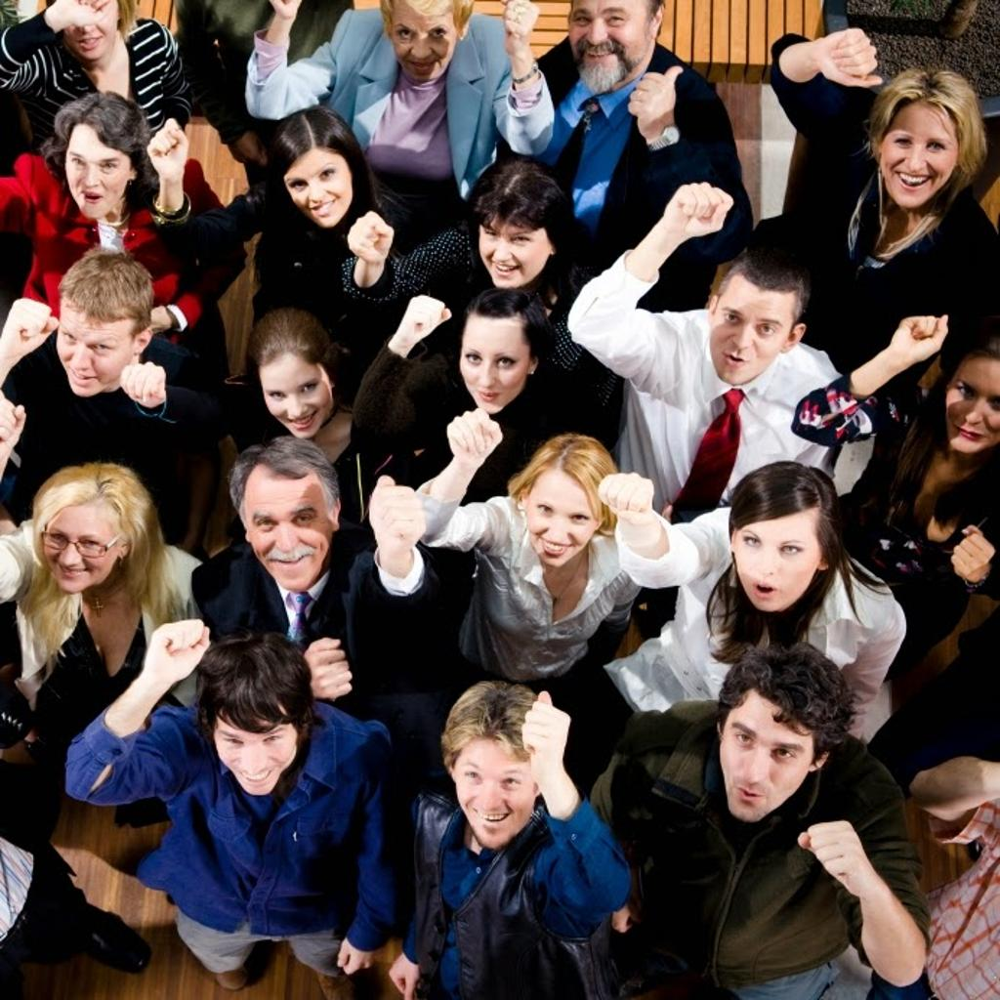

In [18]:
img = cv2.imread("7_Cheering_Cheering_7_16.jpg")
# przygotowanie obrazów: monochromatycznego i RGB (cv2.imread() zwraca obraz w formacie BGR - inna kolejność składowych)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

cv2_imshow(img)

## Kaskada Haara

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/05/opencv-face-detection-with-haar-cascades/

In [19]:
# utworzenie i inicjalizacja detektora
haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")

20


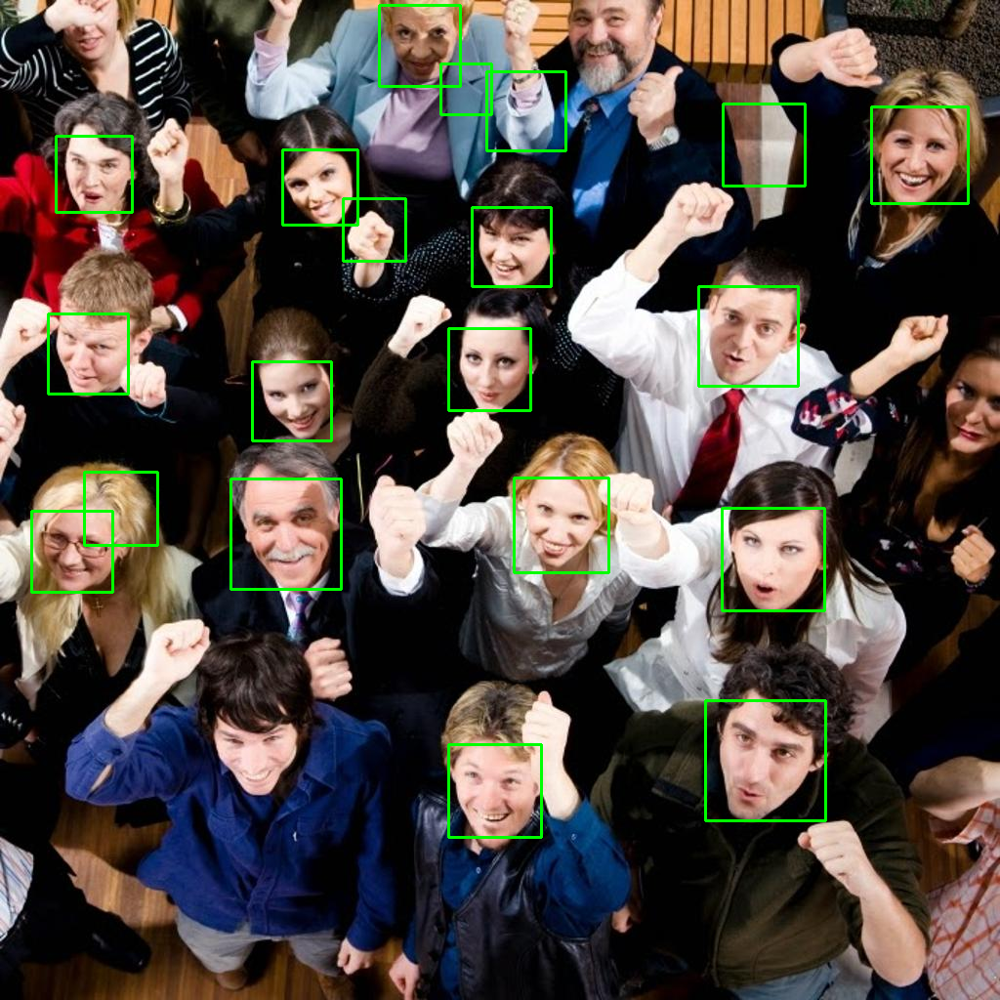

In [20]:
# wywołanie detektora dla określonego obrazu (img_gray)
# wynikiem jest lista prostokątów w formacie [x, y, width, height]
haar_results = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05,
                                         minNeighbors=5, minSize=(30, 30),
																				 flags=cv2.CASCADE_SCALE_IMAGE)
print(len(haar_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_haar = img.copy()
for (x, y, w, h) in haar_results:
  cv2.rectangle(img_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
cv2_imshow(img_haar)

## Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [21]:
# utworzenie i inicjalizacja detektora
hog_svm_detector = dlib.get_frontal_face_detector()

15


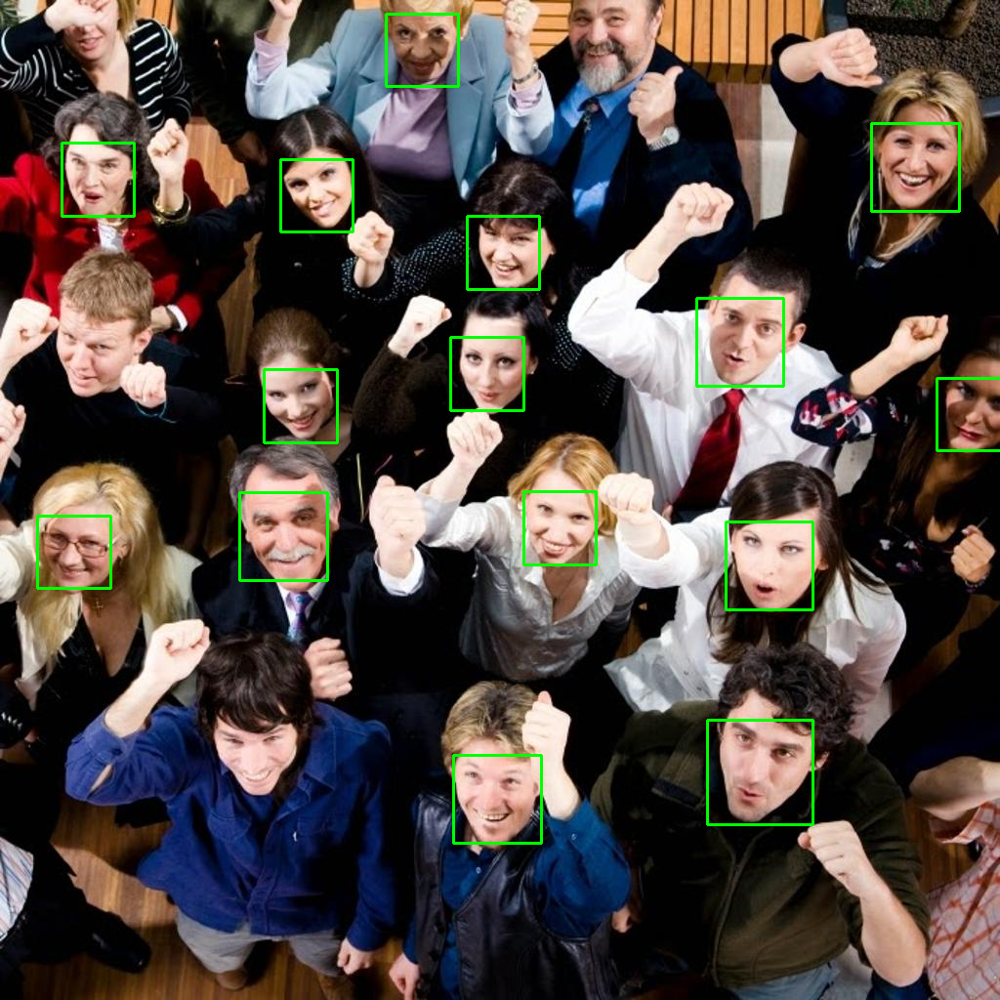

In [22]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów rectangle, zawierających współrzędne lewego górnego i prawego dolnego narożnika prostokąta
hog_svm_results = hog_svm_detector(img_rgb, 1)
print(len(hog_svm_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_hog_svm = img.copy()
for rect in hog_svm_results:
	cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
cv2_imshow(img_hog_svm)

## Splotowa sieć neuronowa (CNN) z biblioteki dlib

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [23]:
# utworzenie i inicjalizacja detektora
cnn1_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')

18


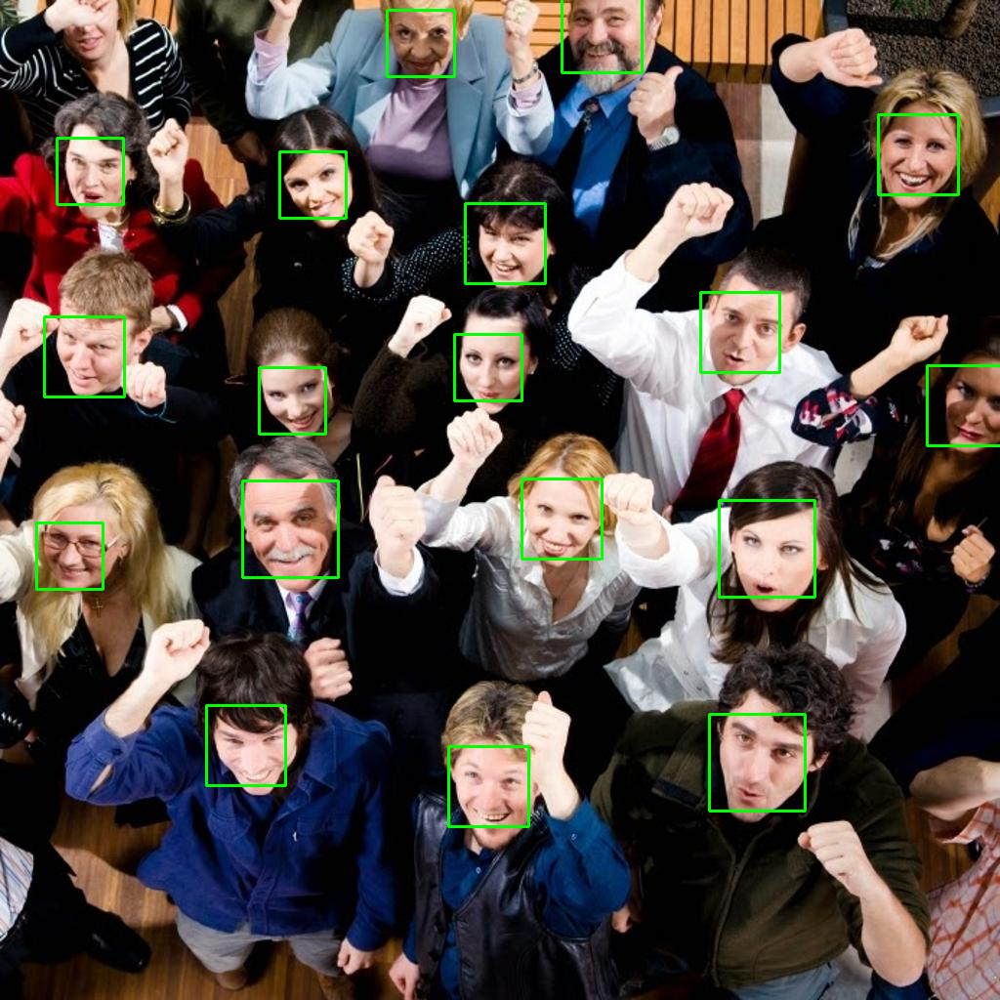

In [24]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów mmod_rectangle, zawierających m.in. pole rect ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
cnn1_results = cnn1_detector(img_rgb, 1)
print(len(cnn1_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_cnn1 = img.copy()
for res in cnn1_results:
	rect = res.rect
	cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
cv2_imshow(img_cnn1)

## InsightFace - inna sieć neuronowa

Opracowano na podstawie: https://github.com/deepinsight/insightface/tree/master/python-package

In [25]:
# utworzenie i inicjalizacja detektora
model_name = 'buffalo_s'  # model: small (_s), medium (_m) lub large (_l)
insf_detector = insightface.app.FaceAnalysis(name=model_name, root='insightface',
                                             allowed_modules=['detection'], providers=['CPUExecutionProvider'])
insf_detector.prepare(ctx_id=0, det_size=(1024, 1024))

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
set det-size: (1024, 1024)


19


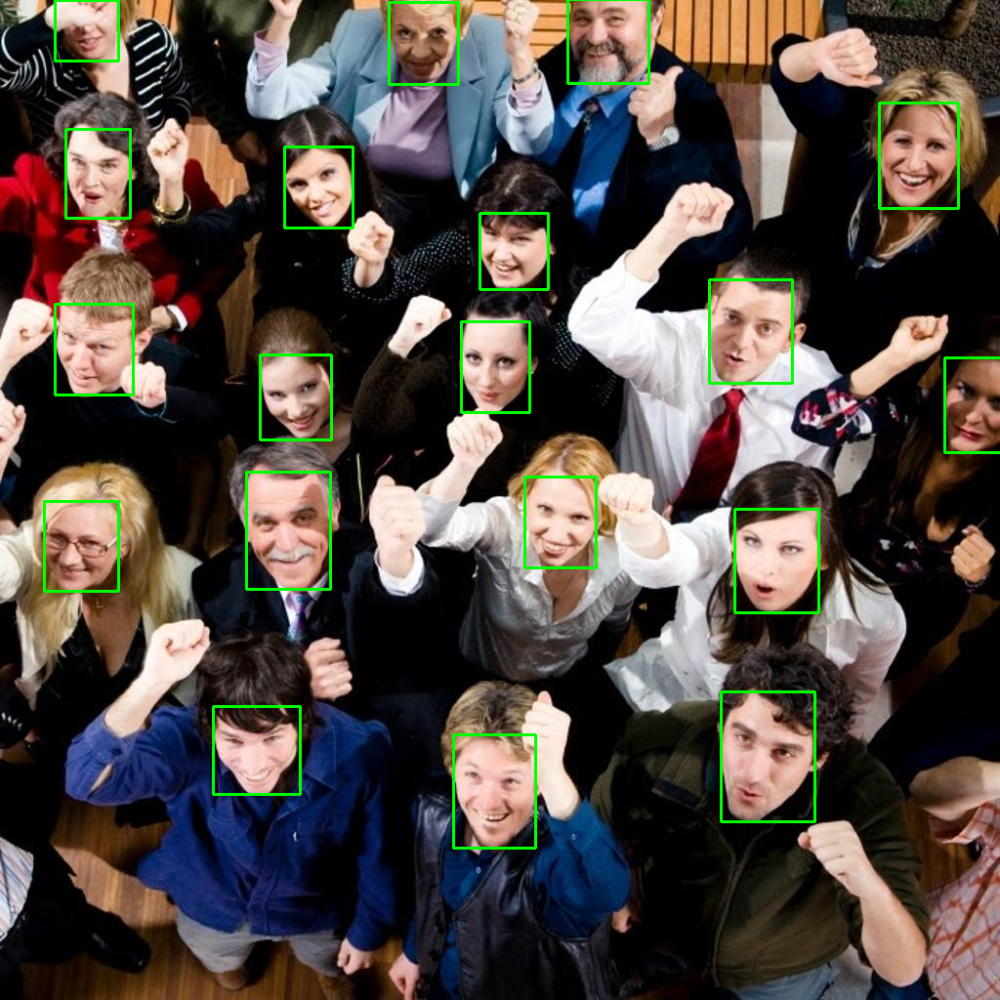

In [26]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów, zawierających m.in. pole bbox ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
insf_results = insf_detector.get(img)
print(len(insf_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_insf = img.copy()
for res in insf_results:
  # współrzędne prostokątów sa zapisane jako liczby rzeczywiste - konwersja do liczb całkowitych
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
cv2_imshow(img_insf)

Porównanie działania algorytmów: <br> <br>
Definicje: <br>
TP - liczba poprawnie wykrytych twarzy <br>
FN - liczba nie wykrytych twarzy <br>
FP - liczba obiektów niepoprawnie rozpoznanych jako twarze <br>
M/W - stosunek niepoprawnie rozpoznanych mezczyzn do niepoprawnie rozpoznanych kobiet <br>
Liczba twarzy w pliku ground_truth.txt: 19 <br>
Kaskada Haara: TP=16, FN=3, FP=5 M/W=2/2<br>
Histogram zorientowanych gradientów: TP=15, FN=4, FP=0 M/W=3/1<br>
Splotowa sieć neuronowa: TP=18, FN=1, FP=0 M/W=0/1<br>
InsightFace: TP=19, FN=0, FP=0 M/W=0/0<br> <br>
Wnioski: <br>
Najlepsze do wykrywania twarzy okazały się sieci neuronowe zapewne wytrenowane na ogromnych zbiorach danych. Z czego sieć InsightFace rozpoznała również twarz zakrytą pięścią. Kaskada Haara poradziła sobie najgorzej zwracając dużo błędnych twarzy natomiast histogram miał porblemy ze znalezieniem twarzy przyciętch oraz zaslonietych np wlosami lub ręką.



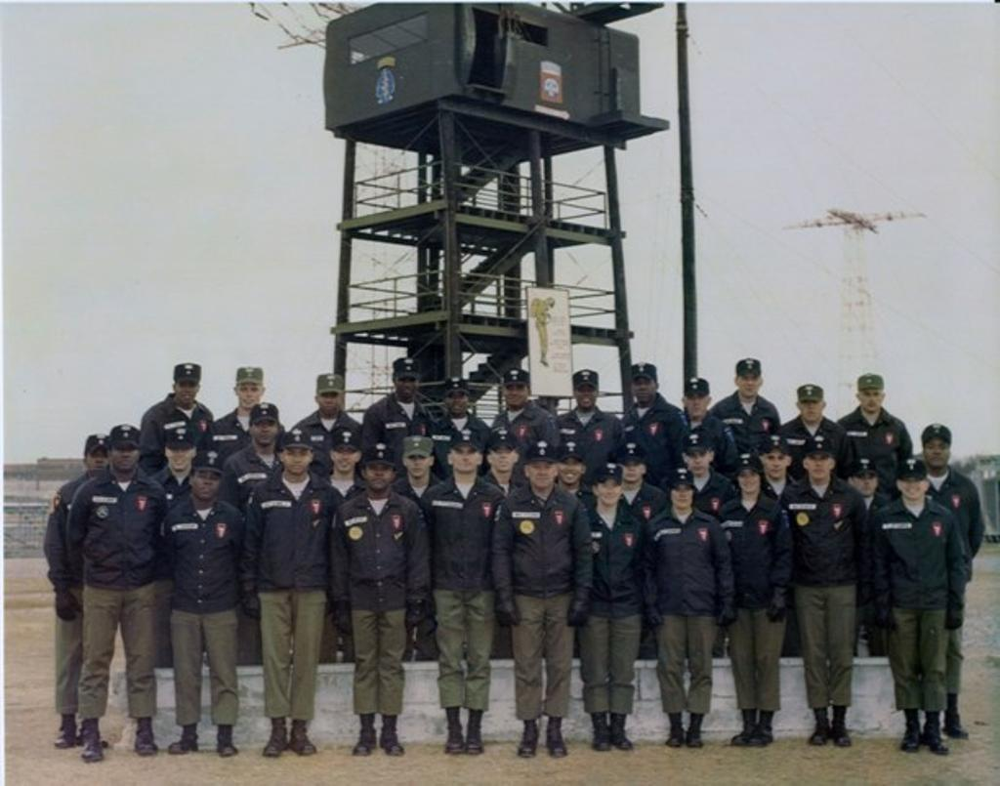

In [40]:
img1 = cv2.imread("48_Parachutist_Paratrooper_Parachutist_Paratrooper_48_283.jpg")
img1_gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img1_rgb = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
cv2_imshow(img1)

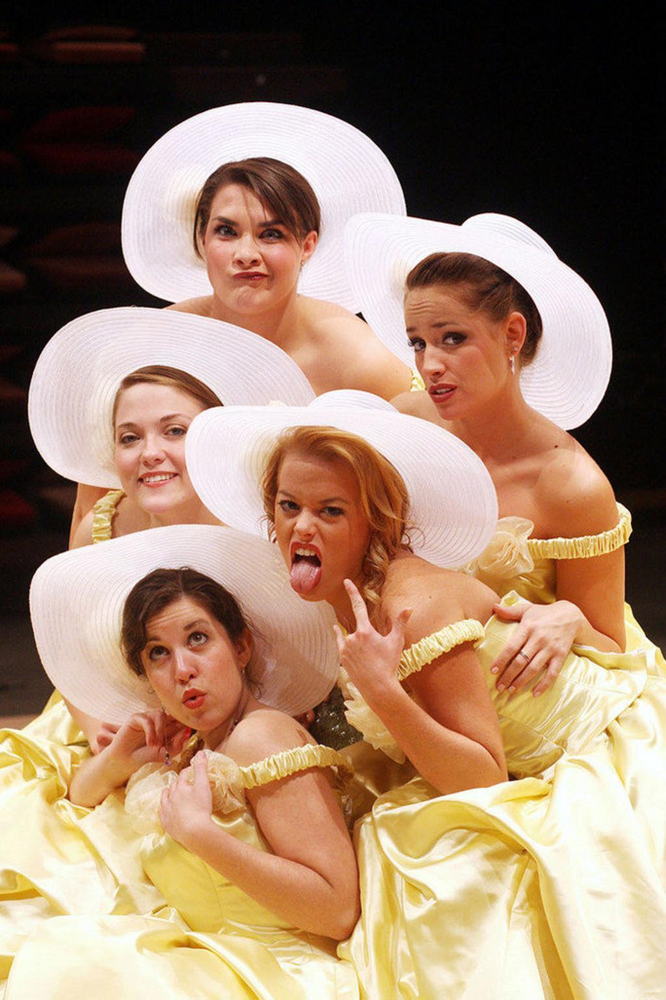

In [41]:
img2 = cv2.imread("51_Dresses_wearingdress_51_53.jpg")
img2_gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
img2_rgb = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
cv2_imshow(img2)

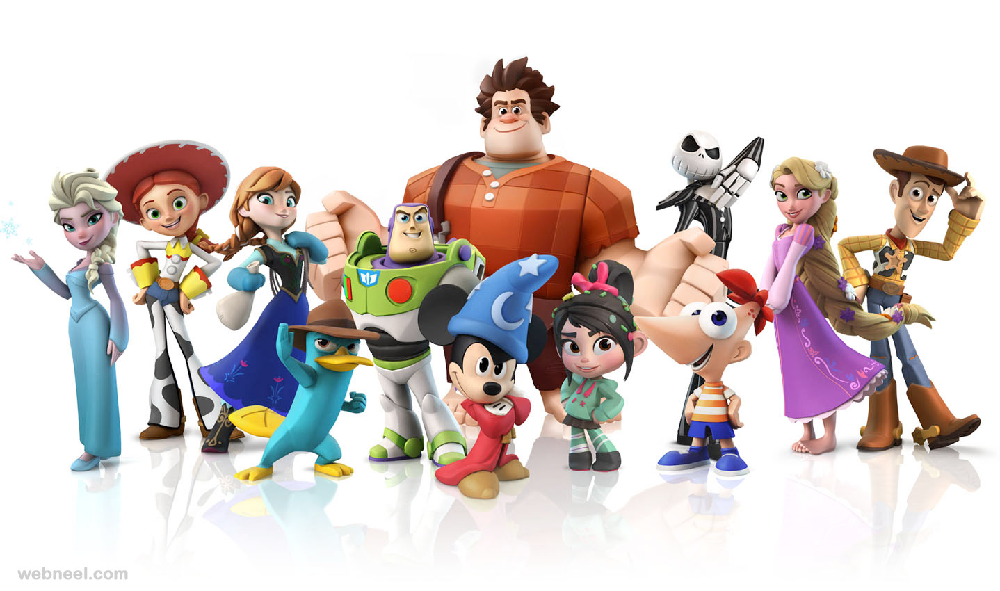

In [42]:
img3 = cv2.imread("kreskowki_testowe.jpg")
img3_gray = cv2.cvtColor(img3, cv2.COLOR_BGR2GRAY)
img3_rgb = cv2.cvtColor(img3, cv2.COLOR_BGR2RGB)
cv2_imshow(img3)

Testy dla obrazu 1:

10


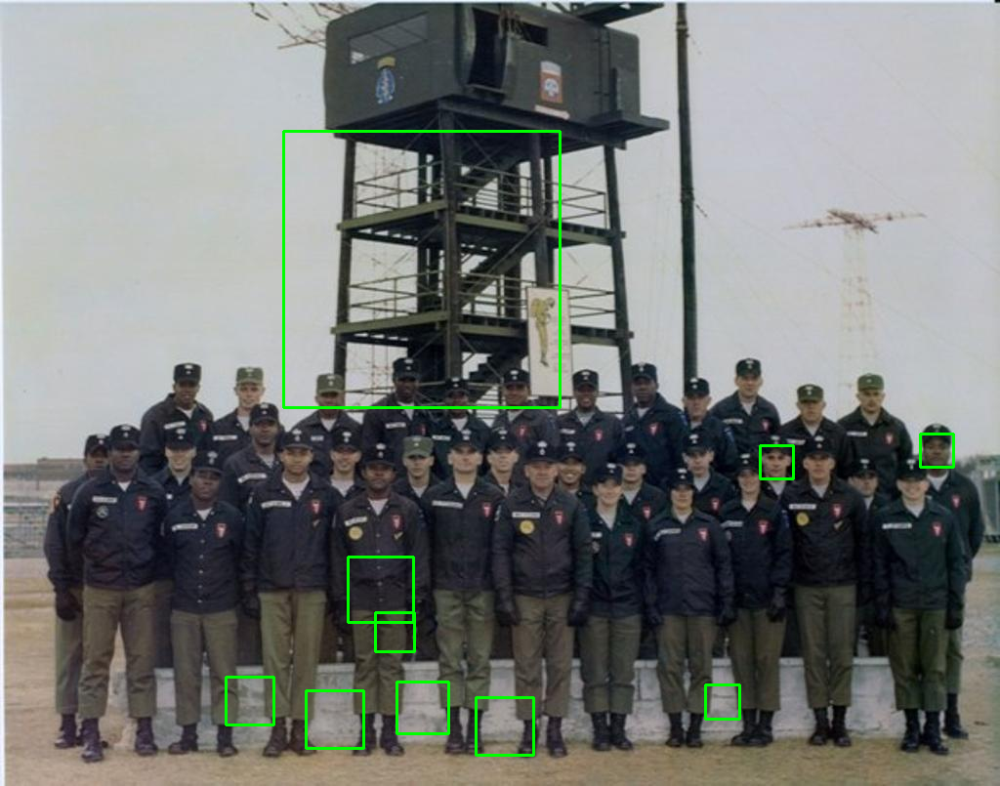

In [43]:
haar_results1 = haar_detector.detectMultiScale(img1_gray, scaleFactor=1.05,
                                         minNeighbors=5, minSize=(30, 30),
																				 flags=cv2.CASCADE_SCALE_IMAGE)
print(len(haar_results1))
img1_haar = img1.copy()
for (x, y, w, h) in haar_results1:
  cv2.rectangle(img1_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
cv2_imshow(img1_haar)

0


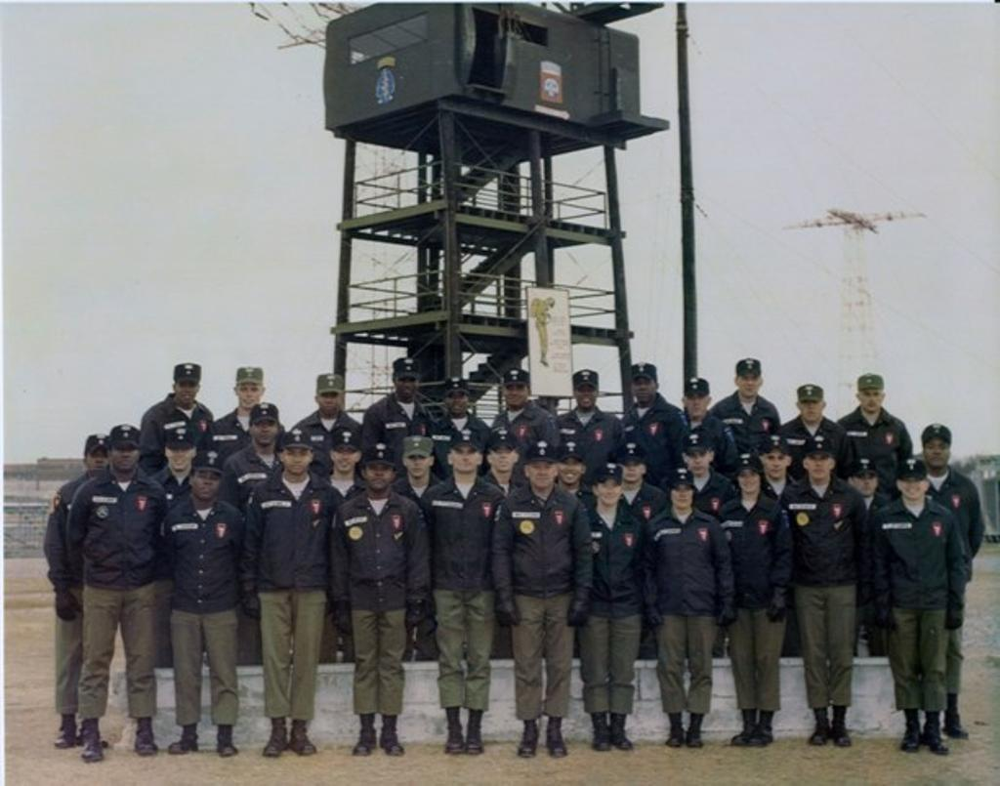

In [44]:
hog_svm_results1 = hog_svm_detector(img1_rgb, 1)
print(len(hog_svm_results1))

img1_hog_svm = img1.copy()
for rect in hog_svm_results1:
	cv2.rectangle(img1_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
cv2_imshow(img1_hog_svm)

18


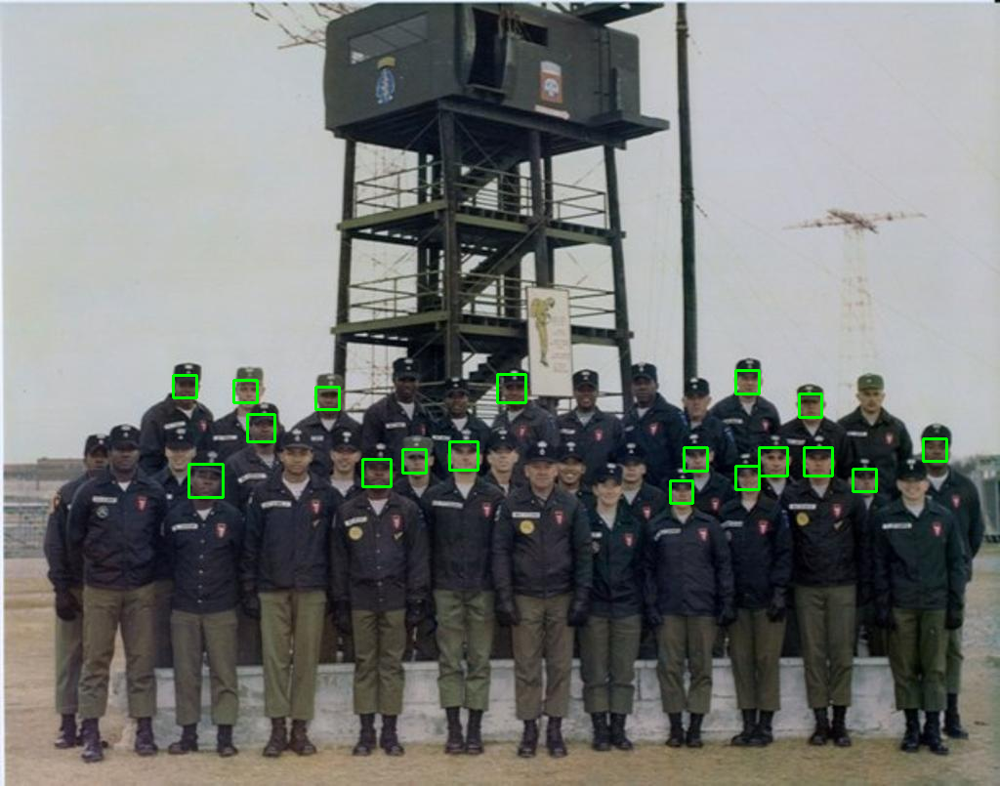

In [66]:
cnn1_results1 = cnn1_detector(img1_rgb, 2)
print(len(cnn1_results1))

img1_cnn1 = img1.copy()
for res in cnn1_results1:
	rect = res.rect
	cv2.rectangle(img1_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
cv2_imshow(img1_cnn1)

35


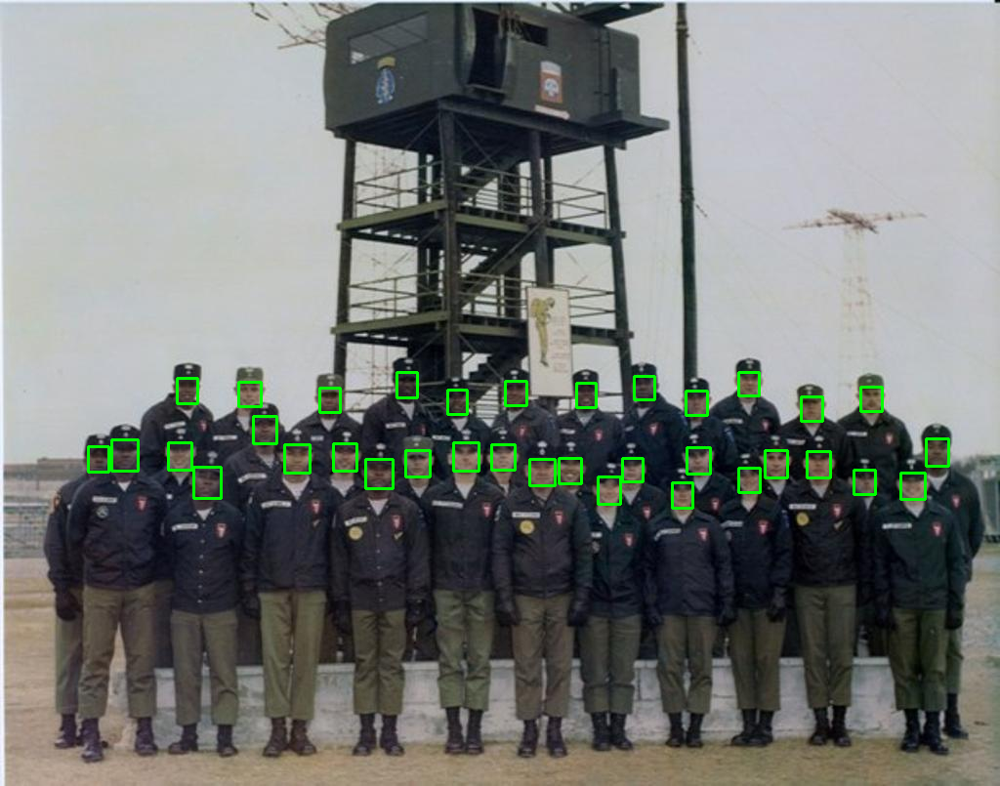

In [46]:
insf_results1 = insf_detector.get(img1)
print(len(insf_results1))

img1_insf = img1.copy()
for res in insf_results1:
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img1_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
cv2_imshow(img1_insf)

Testy dla obrazu 2:

8


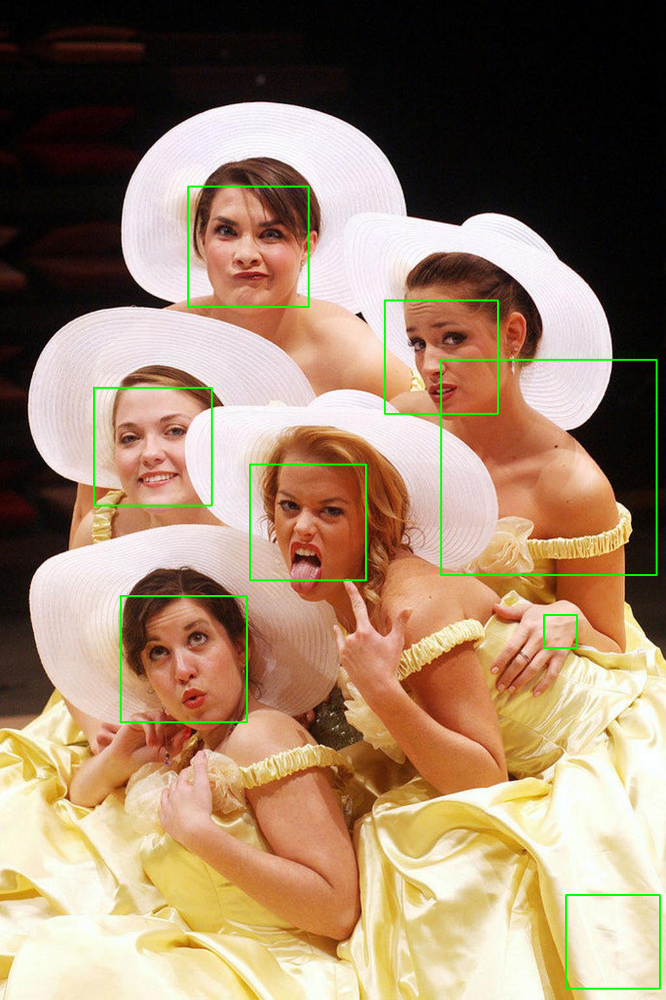

In [47]:
haar_results2 = haar_detector.detectMultiScale(img2_gray, scaleFactor=1.05,
                                         minNeighbors=5, minSize=(30, 30),
																				 flags=cv2.CASCADE_SCALE_IMAGE)
print(len(haar_results2))
img2_haar = img2.copy()
for (x, y, w, h) in haar_results2:
  cv2.rectangle(img2_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
cv2_imshow(img2_haar)

5


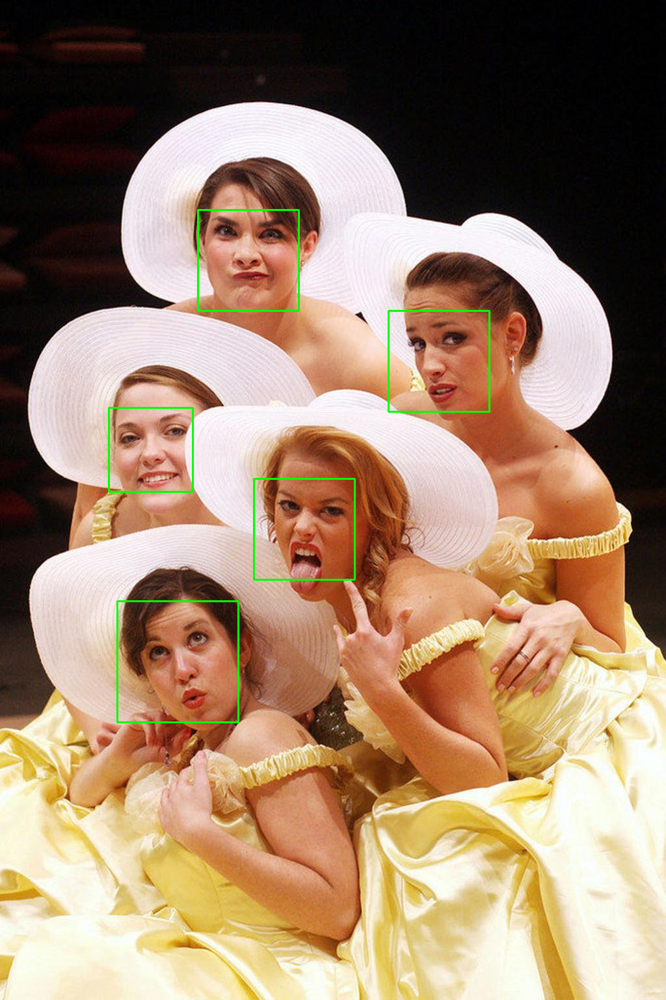

In [48]:
hog_svm_results2 = hog_svm_detector(img2_rgb, 1)
print(len(hog_svm_results2))

img2_hog_svm = img2.copy()
for rect in hog_svm_results2:
	cv2.rectangle(img2_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
cv2_imshow(img2_hog_svm)

5


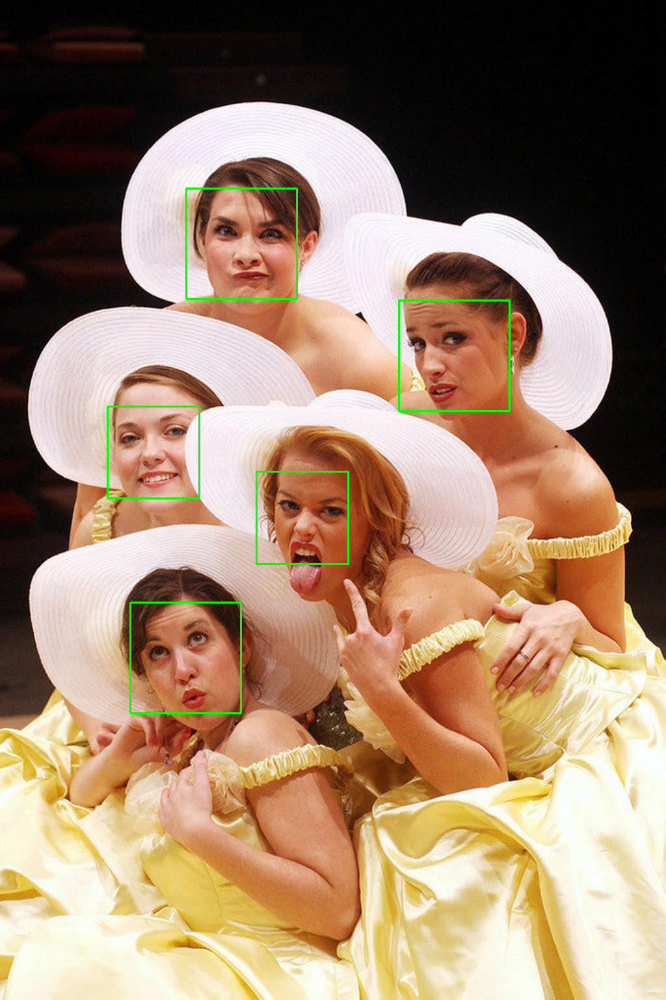

In [49]:
cnn1_results2 = cnn1_detector(img2_rgb, 1)
print(len(cnn1_results2))

img2_cnn1 = img2.copy()
for res in cnn1_results2:
	rect = res.rect
	cv2.rectangle(img2_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
cv2_imshow(img2_cnn1)

5


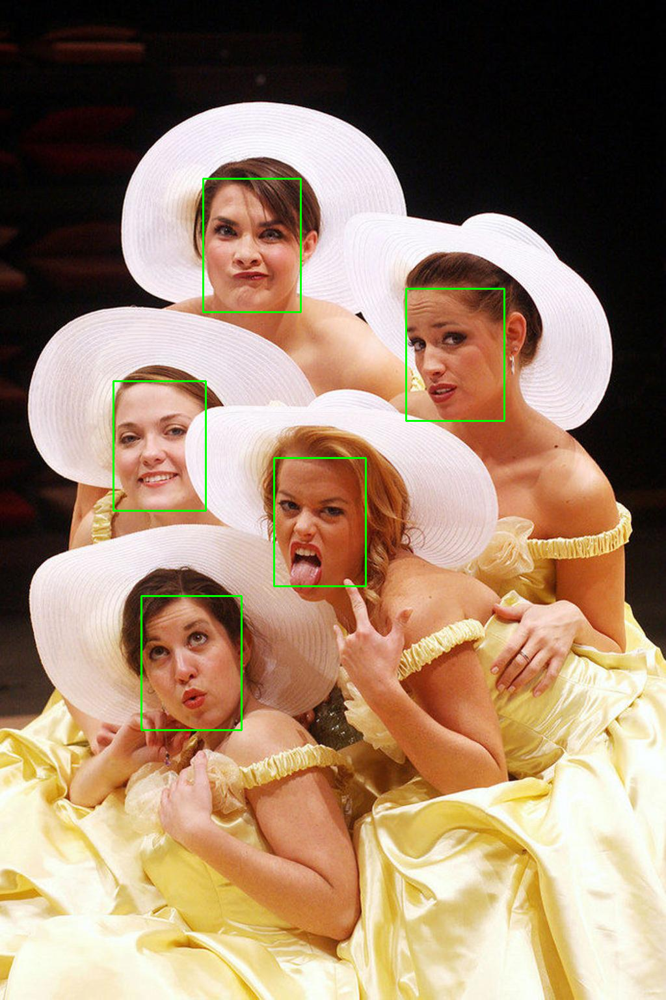

In [51]:
insf_results2 = insf_detector.get(img2)
print(len(insf_results2))

img2_insf = img2.copy()
for res in insf_results2:
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img2_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
cv2_imshow(img2_insf)

Testy dla obrazu 3:

5


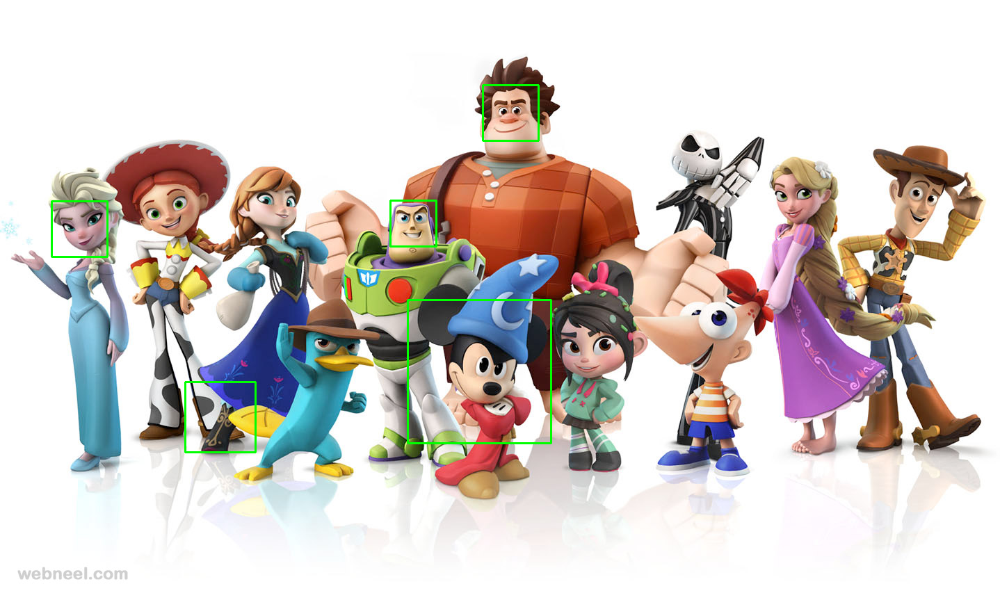

In [52]:
haar_results3 = haar_detector.detectMultiScale(img3_gray, scaleFactor=1.05,
                                         minNeighbors=5, minSize=(30, 30),
																				 flags=cv2.CASCADE_SCALE_IMAGE)
print(len(haar_results3))
img3_haar = img3.copy()
for (x, y, w, h) in haar_results3:
  cv2.rectangle(img3_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
cv2_imshow(img3_haar)

2


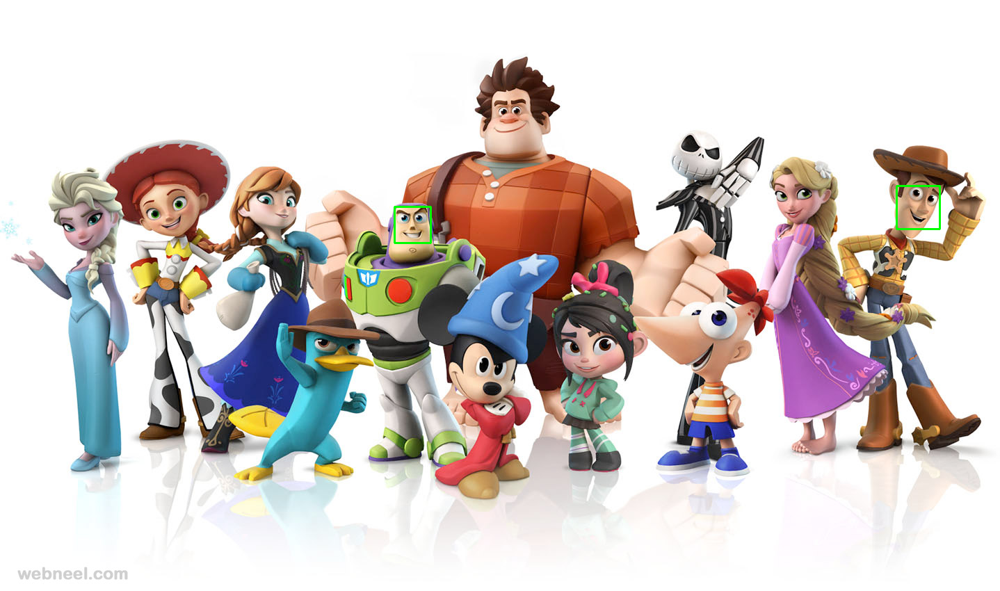

In [53]:
hog_svm_results3 = hog_svm_detector(img3_rgb, 1)
print(len(hog_svm_results3))

img3_hog_svm = img3.copy()
for rect in hog_svm_results3:
	cv2.rectangle(img3_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
cv2_imshow(img3_hog_svm)

6


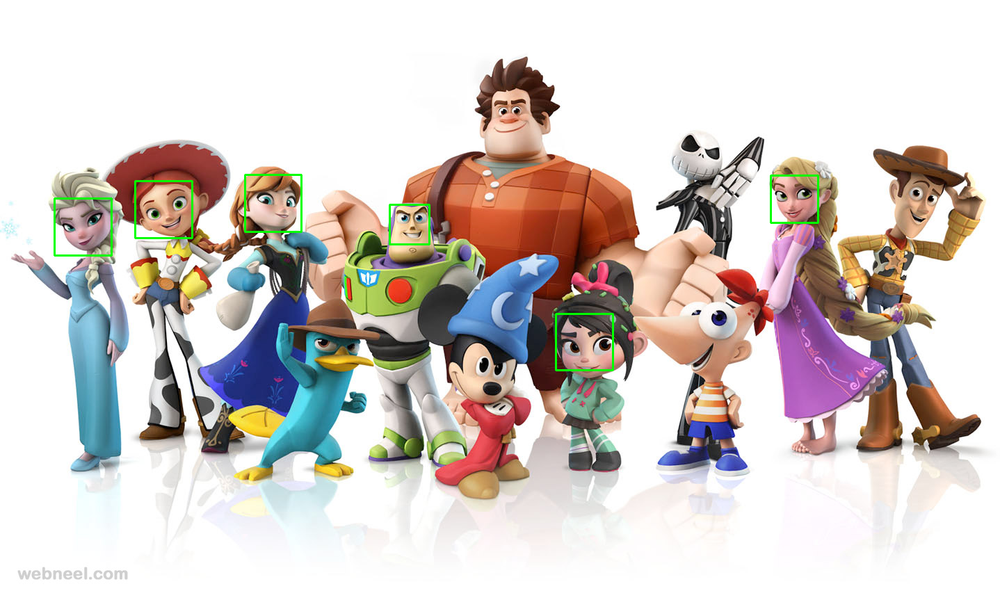

In [54]:
cnn1_results3 = cnn1_detector(img3_rgb, 1)
print(len(cnn1_results3))

img3_cnn1 = img3.copy()
for res in cnn1_results3:
	rect = res.rect
	cv2.rectangle(img3_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
cv2_imshow(img3_cnn1)

8


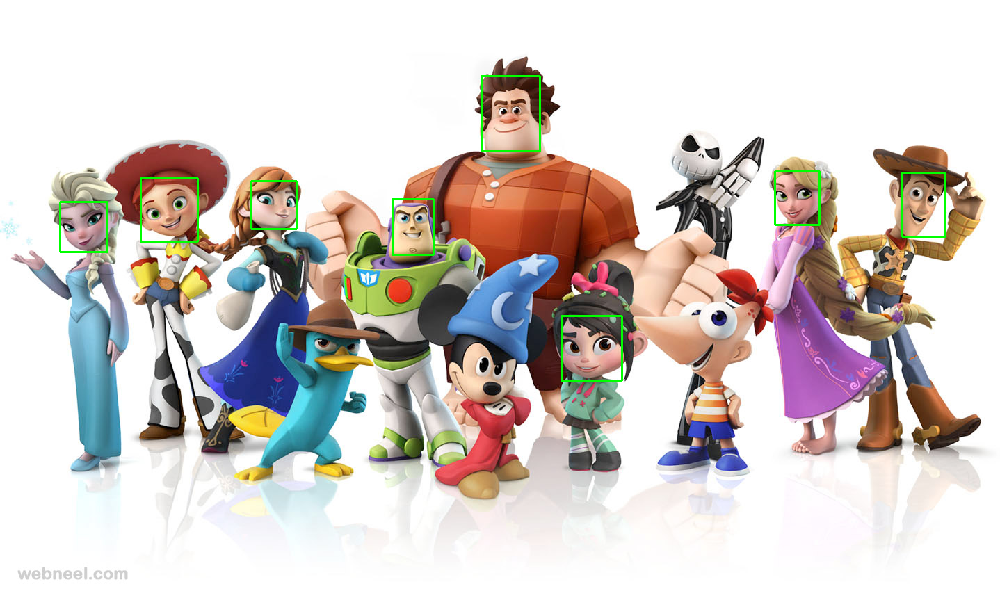

In [55]:
insf_results3 = insf_detector.get(img3)
print(len(insf_results3))

img3_insf = img3.copy()
for res in insf_results3:
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img3_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
cv2_imshow(img3_insf)

Porównanie działania algorytmów: <br> <br>
Definicje: <br>
TP - liczba poprawnie wykrytych twarzy <br>
FN - liczba nie wykrytych twarzy <br>
FP - liczba obiektów niepoprawnie rozpoznanych jako twarze <br> <br>


Obraz pierwszy (48_Parachutist_Paratrooper_Parachutist_Paratrooper_48_283)
```
|        1        | Kaskada Haara | Histogram zorientowanych gradientów | Splotowa sieć neuronowa | InsightFace |
|:---------------:|:-------------:|:-----------------------------------:|:-----------------------:|:-----------:|
|  True Positives |       2       |                  0                  |            0            |      35     |
| False Negatives |       34      |                  19                 |            36           |      1      |
| False Positives |       8       |                  0                  |            0            |      0      |
|   Ground Truth  |       36      |                  36                 |            36           |      36     |

```
Obraz drugi (51_Dresses_wearingdress_51_53)
```
|        2        | Kaskada Haara | Histogram zorientowanych gradientów | Splotowa sieć neuronowa | InsightFace |
|:---------------:|:-------------:|:-----------------------------------:|:-----------------------:|:-----------:|
|  True Positives |       5       |                  5                  |            5            |      5      |
| False Negatives |       0       |                  0                  |            0            |      0      |
| False Positives |       3       |                  0                  |            0            |      0      |
|   Ground Truth  |       5       |                  5                  |            5            |      5      |

```
Obraz trzeci (kreskowki_testowe)
```
|        3        | Kaskada Haara | Histogram zorientowanych gradientów | Splotowa sieć neuronowa | InsightFace |
|:---------------:|:-------------:|:-----------------------------------:|:-----------------------:|:-----------:|
|  True Positives |       4       |                  2                  |            6            |      8      |
| False Negatives |       8       |                  10                 |            6            |      4      |
| False Positives |       1       |                  0                  |            0            |      0      |
|   Ground Truth  |       12      |                  12                 |            12           |      12     |
```

Wnioski: <br>
Dla obrazu drugiego, czyli 5 dosyć dużych oraz wyraznych twarzy, każdy z algorytmów poradził sobie idealnie. Jedynie kaskada Haara zwróciła 3 dodatkowe wyniki. W przypadku obrazu 1., który był najtrudniejszy, jedynie sieć neuronowa InsightFace zwróciła poprawny wynik. Natomiast co ciekawe w przypadku pliku z kreskówkami tylko Kaskada Haara rozpoznała myszkę Mickey.

Zadanie 3. Tabela wszystkich wyników

Miary dla wszystkich obrazów testowych przedstawiono poniżej: <br>
```
|     Obraz    | Ground Truth | True Positives | False Negatives | False Positives |
|:------------:|--------------|:--------------:|:---------------:|-----------------|
|   Cheering   |      19      | 16, 15, 18, 19 |    3, 4, 1, 0   |    5, 0, 0, 0   |
| Parachutists |      36      |   2, 0, 0, 35  |  34, 19, 36, 1  |    8, 0, 0, 0   |
|    Dresses   |       5      |   5, 5, 5, 5   |    0, 0, 0, 0   |    3, 0, 0, 0   |
|   Kreskowki  |      12      |   4, 2, 6, 8   |   8, 10, 6, 4   |    1, 0, 0, 0   |
```
Wnioski: <br>
Obrazem, który najlepiej sprawdzał badane metody rozpoznawania twarzy był obraz Cheering. Jego zróżnicowanie twazrzy sprawiło, że wyraźnie można zaobserwować w czym dana metoda jest dobra a w czym nie daje sobie rady. Obraz Parachutists był najcięższym sprawdzianem, ponieważ twarzy było dużo i były one słabo widoczne, natomiast najłatwiej było rozpoznać twarze na obrazie Dresses. Najciekawszy był za to obraz Kreskówki, ponieważ dobrze na nim widać, która metoda jak kategoryzuje co jest ludzką twarzą a co nie. Np. mimo zarysu twarzy metoda nie uzna jej za ludzką, ponieważ nie jest w kolorze ludzkiej skóry.

Zadanie 4. Pomiar czasów

In [60]:
import time
img = cv2.imread("7_Cheering_Cheering_7_16.jpg")
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
number_of_tests = 20;

In [61]:
start = time.time()
for i in range(number_of_tests):
  haar_results = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05,
                                          minNeighbors=5, minSize=(30, 30),
                                          flags=cv2.CASCADE_SCALE_IMAGE)
end = time.time()
av = (end - start) / number_of_tests
print(av)

1.2596308708190918


In [65]:
start = time.time()
for i in range(number_of_tests):
  hog_svm_results = hog_svm_detector(img_rgb, 1)
end = time.time()
av = (end - start) / number_of_tests
print(av)

0.6633345007896423


In [63]:
start = time.time()
for i in range(number_of_tests):
  cnn1_results = cnn1_detector(img_rgb, 1)
end = time.time()
av = (end - start) / number_of_tests
print(av)

0.16920099258422852


In [64]:
start = time.time()
for i in range(number_of_tests):
  insf_results = insf_detector.get(img)
end = time.time()
av = (end - start) / number_of_tests
print(av)

0.11053347587585449


Otrzymane wyniki przedstawiono poniżej:
```
|                Metoda               | Średni czas [s] |
|:-----------------------------------:|:---------------:|
|            Kaskada Haara            |       1.26      |
| Histogram zorientowanych gradientów |       0.66      |
|       Splotowa sieć neuronowa       |       0.17      |
|             InsightFace             |       0.11      |
```
Wnioski: <br>
Metody bazujące na sieciach neuronowych okazały się najszybsze oraz najlepsze w rozpoznawaniu twarzy. Natomiast jedno wykonanie Kaskady Haara zajmowało aż 1,26 sekundy co świadczy o jej wysokiej złożoności obliczeniowej.